In [144]:
# %pip -q install gtbook # also installs latest gtsam pre-release

In [145]:
# %pip install open3d

In [4]:
import os
import numpy as np
import cv2
import gtsam
import gtsam.utils.plot as gtsam_plot
import math
import plotly.graph_objects as go
import itertools
import pickle
import matplotlib.pyplot as plt
import scipy
import tqdm
import open3d as o3d
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

In [7]:
data_dir = 'buddha'
# data_dir = "/content/drive/MyDrive/Colab Notebooks/HW4_Buddha/buddha_images"
image_list = sorted(os.listdir(data_dir))
N = len(image_list)
Images = [cv2.cvtColor(cv2.imread(os.path.join(data_dir, filename)), cv2.COLOR_BGR2GRAY) for filename in image_list]
print(len(Images))

24


In [148]:
h, w = Images[0].shape[:2]
K = np.array([[1500, 0, w/2],
              [0, 1500, h/2],
              [0, 0, 1]], dtype=np.float32)

In [149]:
def FindPoints(img1, img2):
    sift = cv2.SIFT_create()
    kp1, des1 = sift.detectAndCompute(img1, None)
    kp2, des2 = sift.detectAndCompute(img2, None)
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(des1, des2, k=2)
    good_matches = []
    for m, n in matches:
        if m.distance < 0.75 * n.distance:
            good_matches.append(m)
    src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    return src_pts, dst_pts

def custom_non_maximum_suppression(detected_points):
    h, w = Images[0].shape[:2]
    output_mask = np.zeros((h, w), dtype=np.uint8)

    pointsR = np.array([pt.response for pt in detected_points])
    sortedI = np.flip(np.argsort(pointsR))

    sortedPts = np.rint([pt.pt for pt in detected_points])[sortedI].astype(int)

    nms = []
    for point, i in zip(sortedPts, sortedI):
        if output_mask[point[1], point[0]] == 0:
            nms.append(i)
            cv2.circle(output_mask, tuple(point), 2, 255, -1)
    return nms

stored_keypoints = None
stored_descriptors = None
num_features = 1000
descriptor = cv2.SIFT_create(num_features, nOctaveLayers=3, contrastThreshold=0.04)
matcher = cv2.BFMatcher(cv2.NORM_L2)

In [150]:
def match_images(img1, img2, img1_index, img2_index):
    global stored_keypoints, stored_descriptors

    if stored_keypoints is None or stored_descriptors is None:
        keypoints1, descriptors1 = descriptor.detectAndCompute(img1, None)
        nms_mask1 = custom_non_maximum_suppression(keypoints1)
        keypoints1 = np.array(keypoints1)[nms_mask1]
        descriptors1 = np.array(descriptors1)[nms_mask1]
    else:
        keypoints1 = stored_keypoints
        descriptors1 = stored_descriptors

    keypoints2, descriptors2 = descriptor.detectAndCompute(img2, None)
    nms_mask2 = custom_non_maximum_suppression(keypoints2)
    keypoints2 = np.array(keypoints2)[nms_mask2]
    descriptors2 = np.array(descriptors2)[nms_mask2]

    stored_keypoints = keypoints2
    stored_descriptors = descriptors2
    matches = matcher.knnMatch(descriptors1, descriptors2, k=2)
    good_matches = [m for m, n in matches if m.distance < 0.75 * n.distance]
    img1_points = np.float32([keypoints1[m.queryIdx].pt for m in good_matches])
    img2_points = np.float32([keypoints2[m.trainIdx].pt for m in good_matches])
    PlotEpipolarLines(img1, img2, img1_points, img2_points)

    return img1_points, img2_points

def PlotEpipolarLines(img1, img2, img1_points, img2_points):
    src_pts, dst_pts = FindPoints(img1, img2)
    img1_with_points = cv2.drawKeypoints(img1, [cv2.KeyPoint(x, y, 5) for (x, y) in src_pts[:, 0]], None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    img2_with_points = cv2.drawKeypoints(img2, [cv2.KeyPoint(x, y, 5) for (x, y) in dst_pts[:, 0]], None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    plt.figure(figsize=(16, 9))
    plt.subplot(1, 2, 1)
    plt.imshow(img1_with_points, cmap='gray')
    plt.title('Image 1 with Feature Points')
    plt.subplot(1, 2, 2)
    plt.imshow(img2_with_points, cmap='gray')
    plt.title('Image 2 with Feature Points')
    plt.show()

    F, mask = cv2.findFundamentalMat(img1_points, img2_points, cv2.FM_RANSAC)
    lines1 = cv2.computeCorrespondEpilines(img2_points, 2, F)
    lines1 = lines1.reshape(-1, 3)
    lines2 = cv2.computeCorrespondEpilines(img1_points, 1, F)
    lines2 = lines2.reshape(-1, 3)
    img1_points_int = np.int32(img1_points)
    img2_points_int = np.int32(img2_points)

    img1_epilines = img1_with_points.copy()
    img2_epilines = img2_with_points.copy()

    for r, pt1, pt2 in zip(lines1, img1_points_int, img2_points_int):
        color = tuple(np.random.randint(0, 255, 3).tolist())
        x0, y0 = map(int, [0, -r[2] / r[1]])
        x1, y1 = map(int, [img1.shape[1], -(r[2] + r[0] * img1.shape[1]) / r[1]])
        img2_epilines = cv2.line(img2_epilines, (x0, y0), (x1, y1), color, 1)
        img1_epilines = cv2.circle(img1_epilines, tuple(pt1), 5, color, -1)

        x0, y0 = map(int, [0, -r[2] / r[1]])
        x1, y1 = map(int, [img2.shape[1], -(r[2] + r[0] * img2.shape[1]) / r[1]])
        img1_epilines = cv2.line(img1_epilines, (x0, y0), (x1, y1), color, 1)
        img2_epilines = cv2.circle(img2_epilines, tuple(pt2), 5, color, -1)
    plt.figure(figsize=(16, 9))
    plt.subplot(1, 2, 1)
    plt.imshow(img1_epilines, cmap='gray')
    plt.title('Image 1 with Epipolar Lines')
    plt.subplot(1, 2, 2)
    plt.imshow(img2_epilines, cmap='gray')
    plt.title('Image 2 with Epipolar Lines')
    plt.show()


In [151]:
def ComputeEssentialMatrix(q1, q2):
    E, mask = cv2.findEssentialMat(q1, q2, K, cv2.RANSAC, 0.999, 1.0)
    q1 = q1[mask.ravel() == 1]
    q2 = q2[mask.ravel() == 1]
    return E, q1, q2, mask

def CalculateTransfomationMatrix(Rotation, translation_vector):
    transformation_matrix = np.eye(4, dtype=np.float64)
    transformation_matrix[:3, :3] = Rotation
    if translation_vector.ndim == 1:
      transformation_matrix[:3, 3] = translation_vector
    else:
      transformation_matrix[:3, 3] = translation_vector.ravel()
    return transformation_matrix

def get_projection_matrix(T):
    return K @ np.linalg.inv(T)[:3, :]

def Trangulation(q1, q2, proj_matrix1, proj_matrix2):
    points_4d = cv2.triangulatePoints(proj_matrix1, proj_matrix2, q1.T, q2.T)
    points_3d = points_4d[:3, :] / points_4d[3, :]
    valid_mask = points_3d[2, :] > 0
    points_3d = points_3d[:, valid_mask]
    q1, q2 = q1[valid_mask], q2[valid_mask]
    return points_3d.T, q1, q2

class Point3D:
    def __init__(self, coords, origin):
        self.coords = np.array(coords, dtype=np.float32)
        self.origin = origin

def find_3d_point(cloud, point, index):
    for pt in cloud:
        try:
            if np.array_equal(point.origin[index], pt.origin[index]):
                return True, pt
        except KeyError:
            pass
    return False, None

def update_cloud(cloud, index, points_3D, q1, q2):
    count = 0
    for i, point_value in enumerate(points_3D):
        point = Point3D(point_value, {index: q1[i], index+1: q2[i]})
        success, old_point = find_3d_point(cloud, point, index)

        if success:
            old_point.origin[index+1] = q2[i]
        else:
            cloud.append(point)

def CreatePointCloud(index, prev_keypoints, cloud, q1):
    matched_2d = []
    matched_3d = []
    matched_indices = []

    for i, point in enumerate(q1):
        for old_point in prev_keypoints:
            if np.array_equal(point, old_point):
                matched_2d.append(point)
                matched_indices.append(i)

    for i, point in enumerate(matched_2d):
        for point_3d in cloud:
            try:
                if np.array_equal(point, point_3d.origin[index]):
                    matched_3d.append(point_3d.coords)
                    break
            except KeyError:
                continue
    matched_2d = np.array(matched_2d, dtype=np.float32)
    matched_3d = np.array(matched_3d, dtype=np.float32)

    return matched_2d, matched_3d, matched_indices


Image 0 and 1


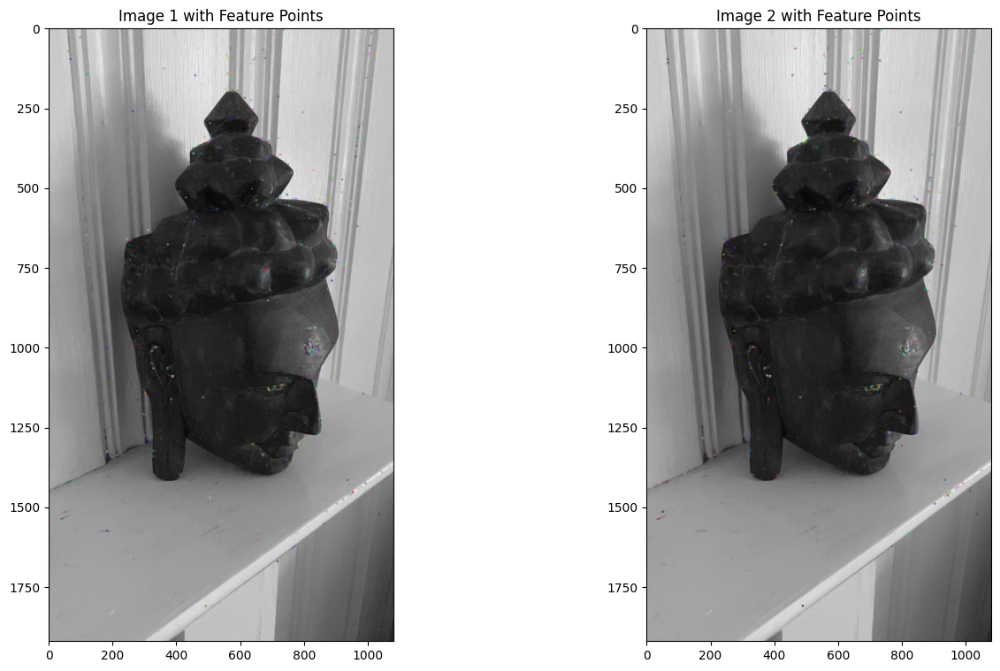

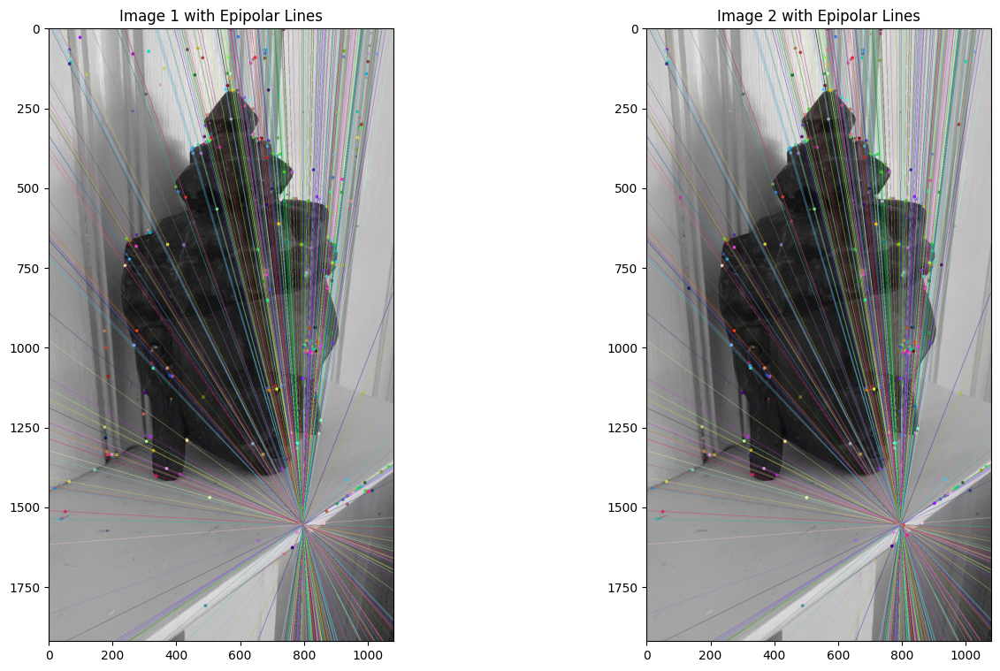

In [152]:
camera_poses = []
print(f"Image 0 and 1")
image1, image2 = Images[0], Images[1]
camera_poses = [None, None]
q1, q2 = match_images(image1, image2, 0, 1)
E, q1, q2, mask = ComputeEssentialMatrix(q1, q2)
_, R, t, _ = cv2.recoverPose(E, q1, q2, K)
T_2_1 = CalculateTransfomationMatrix(R, t)
camera_poses[0] = np.eye(4)
camera_poses[1] = np.linalg.inv(T_2_1)

P1 = get_projection_matrix(np.eye(4))
P2 = get_projection_matrix(camera_poses[1])

points_3D, q1, q2 = Trangulation(q1, q2, P1, P2)

pointcloud = [Point3D(point, {0: q1[i], 0 + 1: q2[i]}) for i, point in enumerate(points_3D)]
prev_keypoints = q2

Image 1 and 2


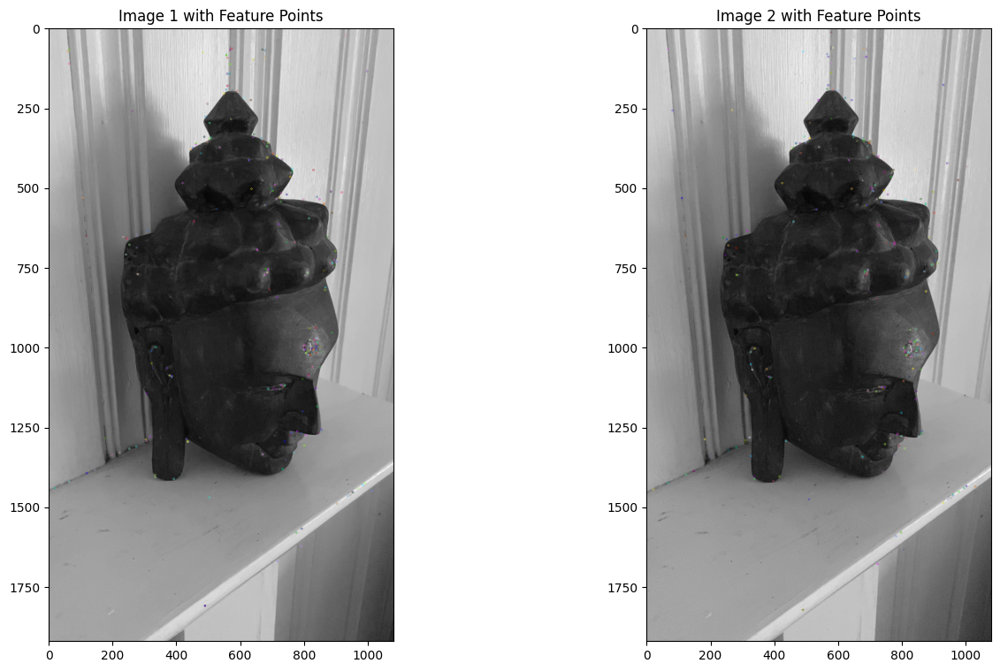

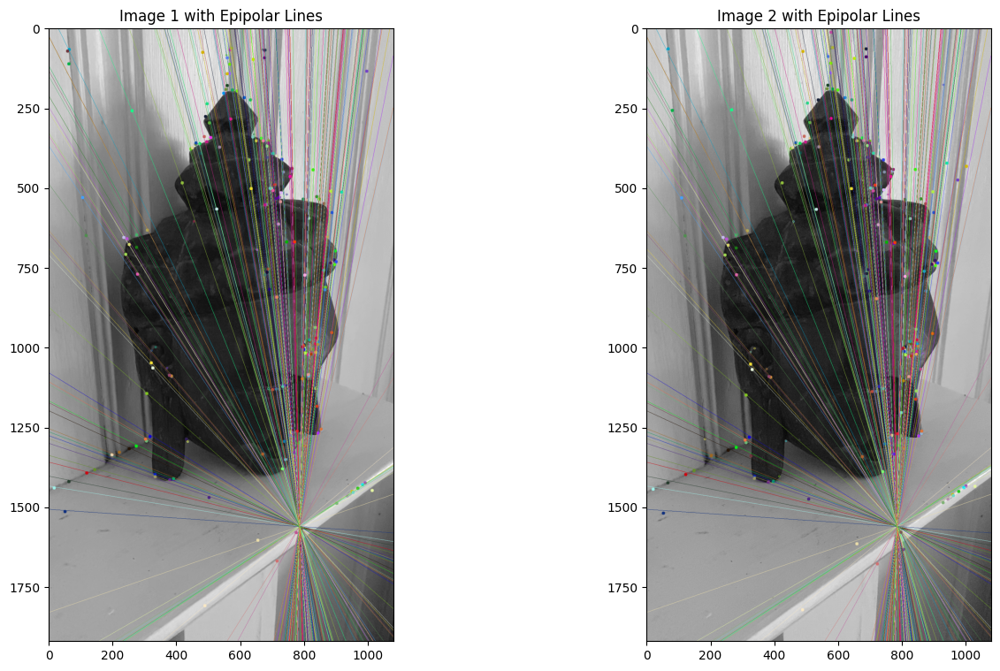

Image 2 and 3


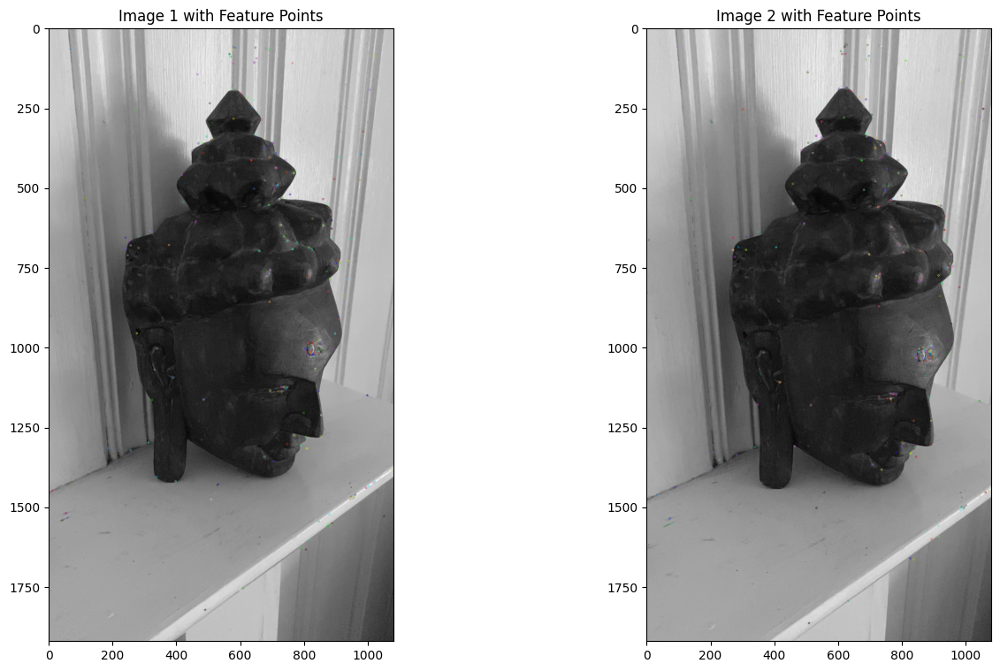

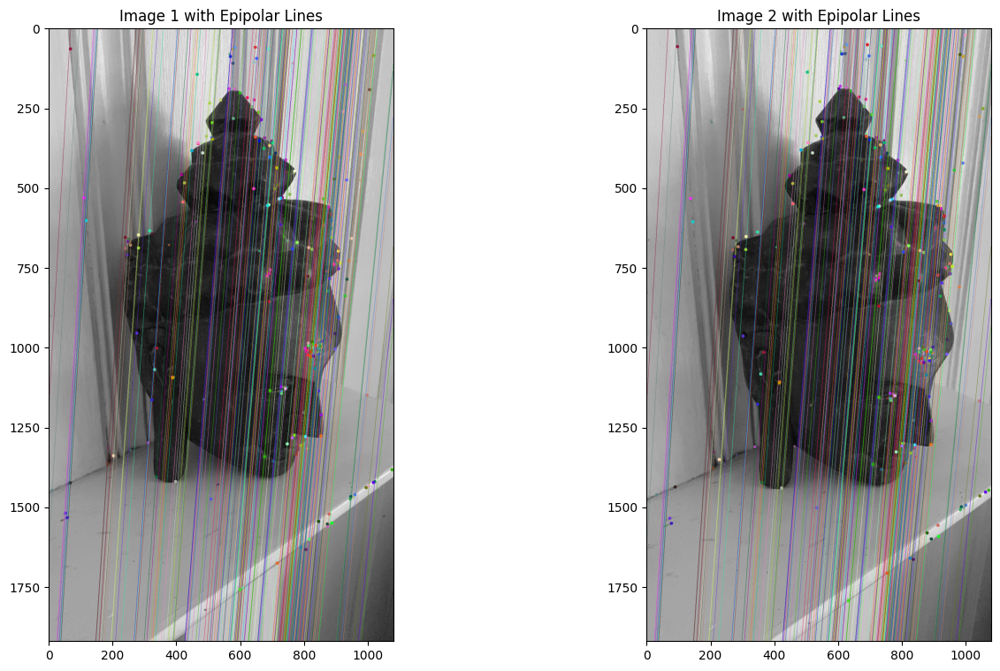

Image 3 and 4


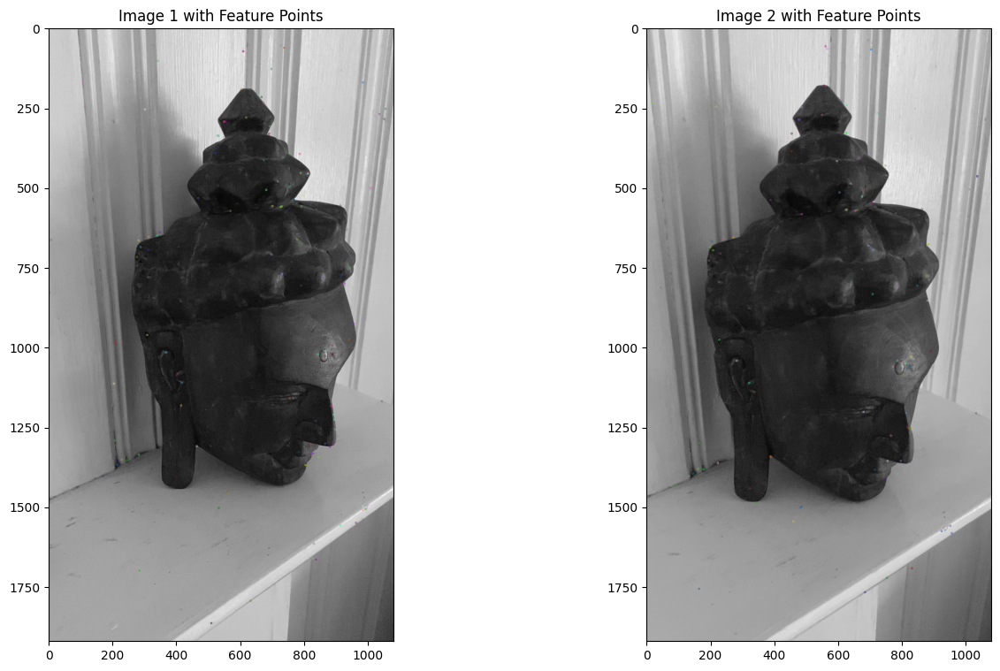

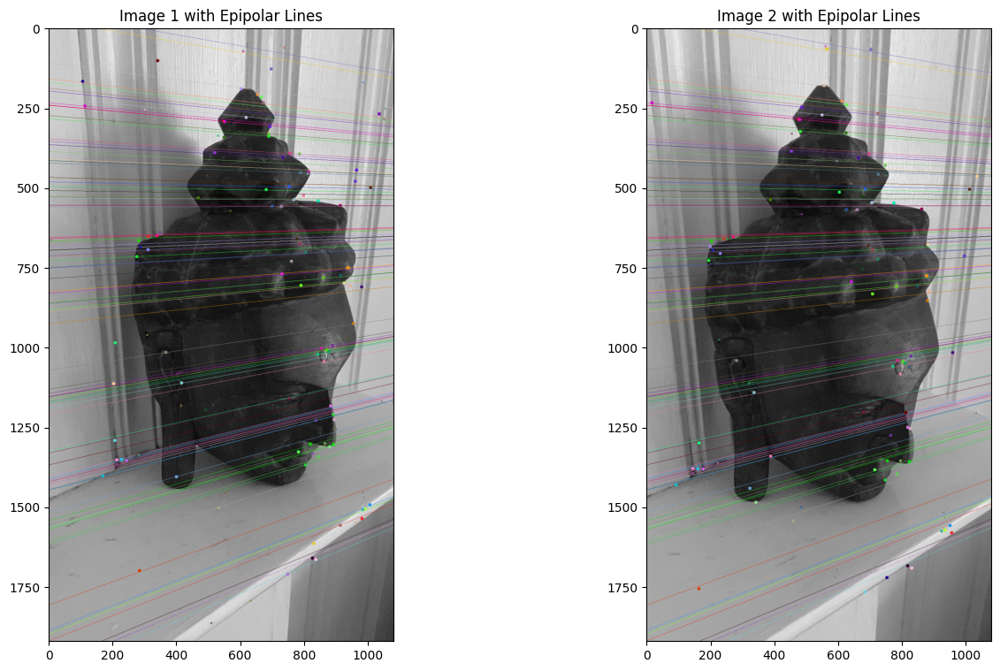

Image 4 and 5


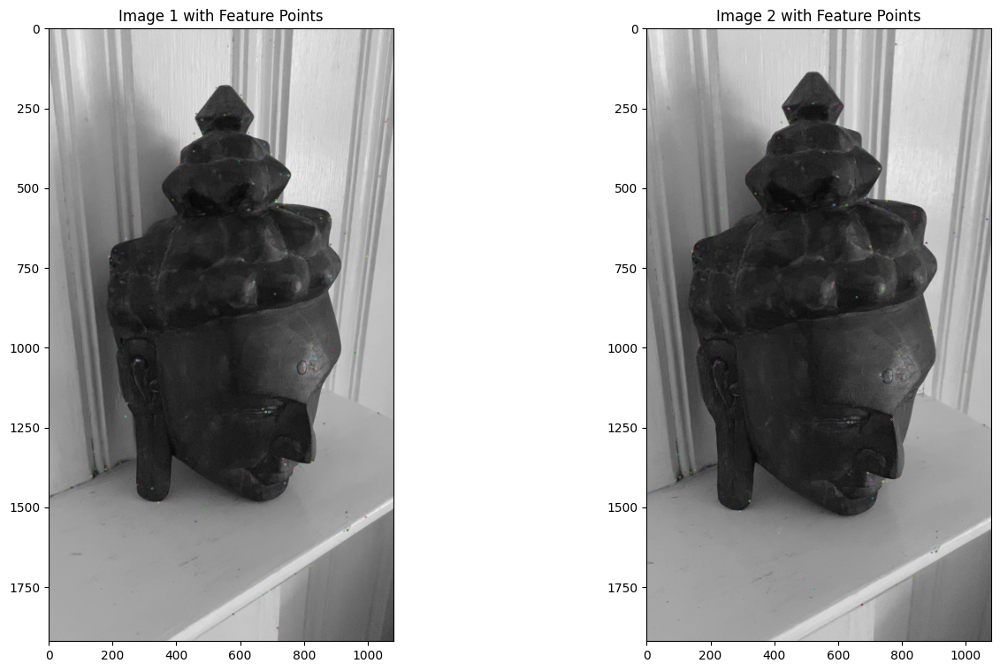

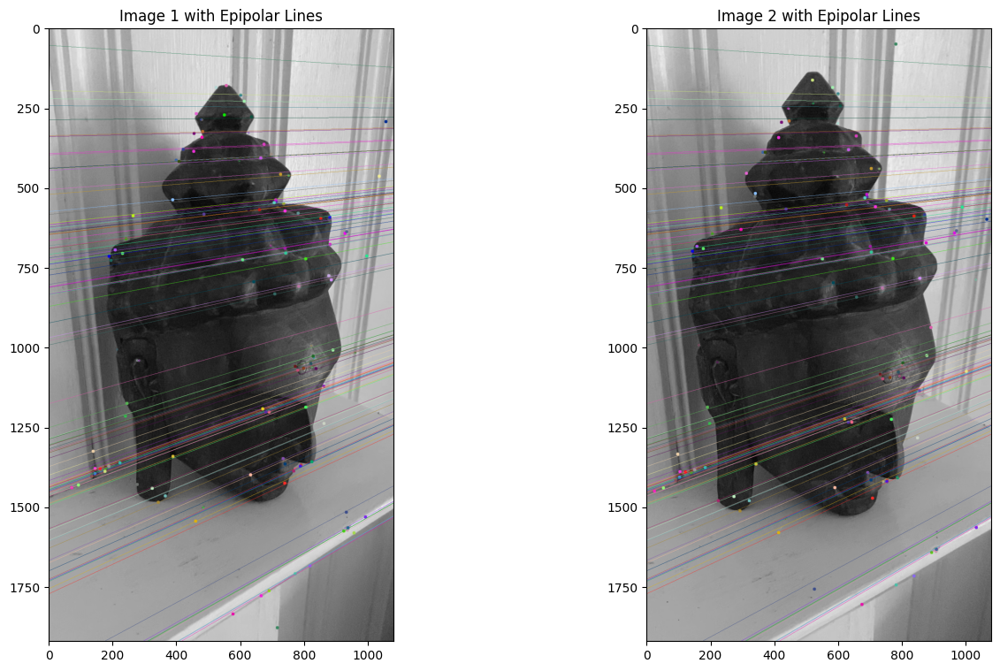

Image 5 and 6


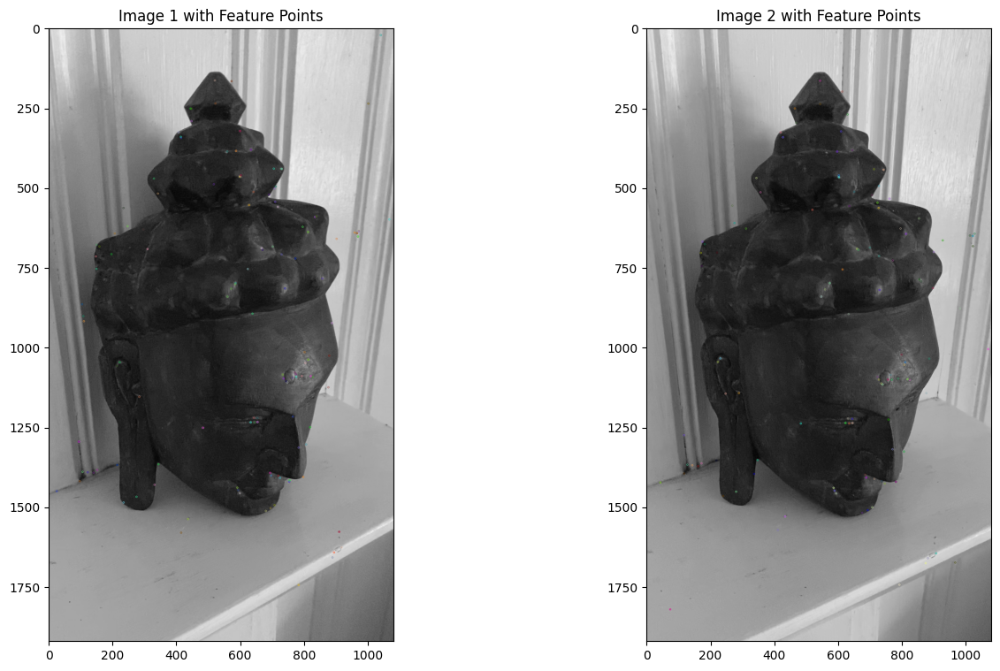

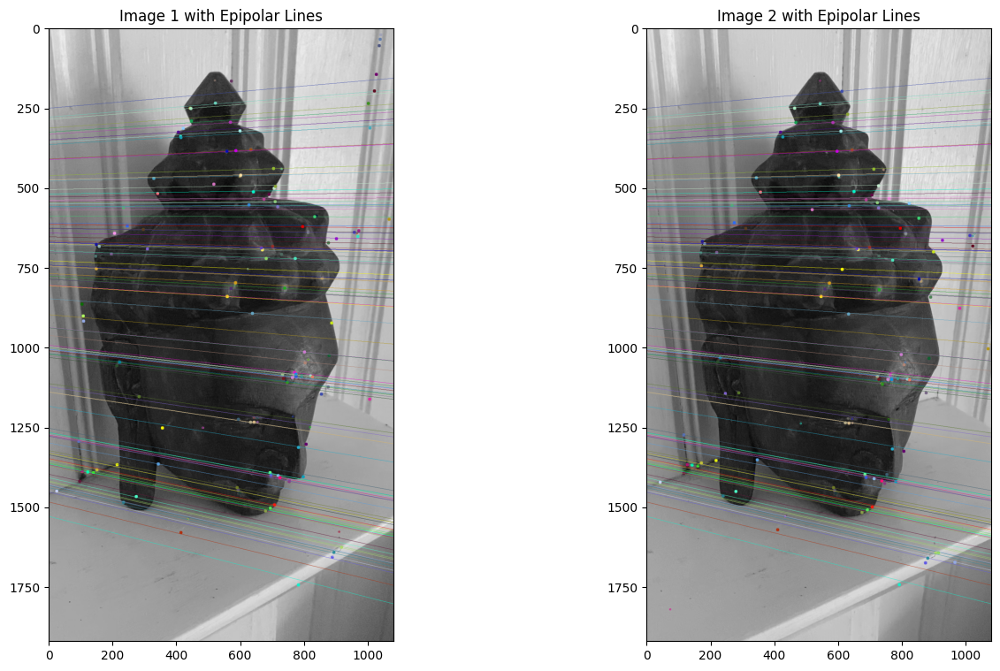

Image 6 and 7


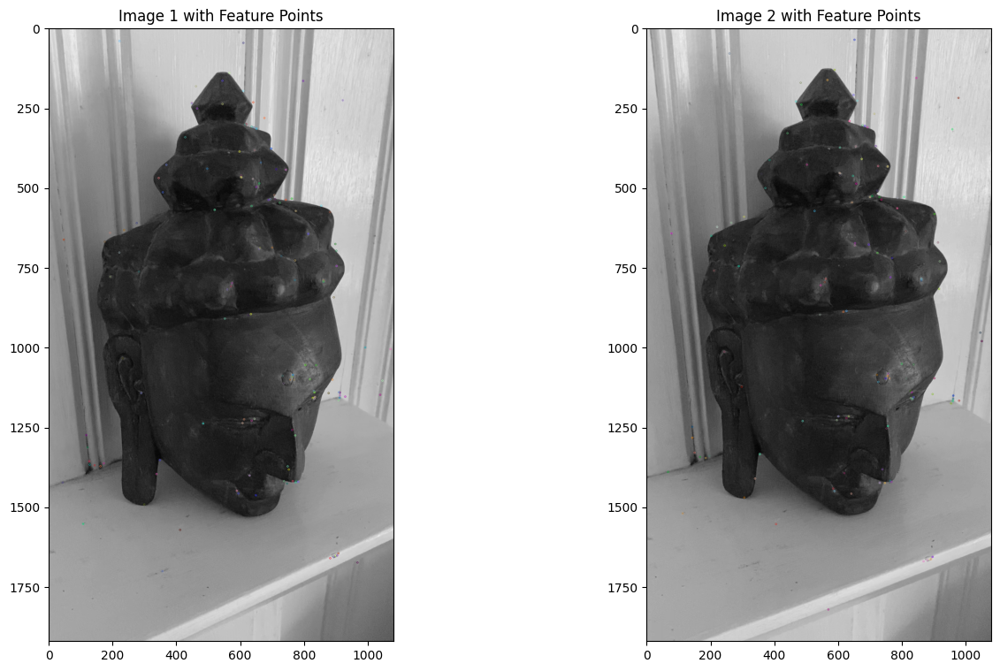

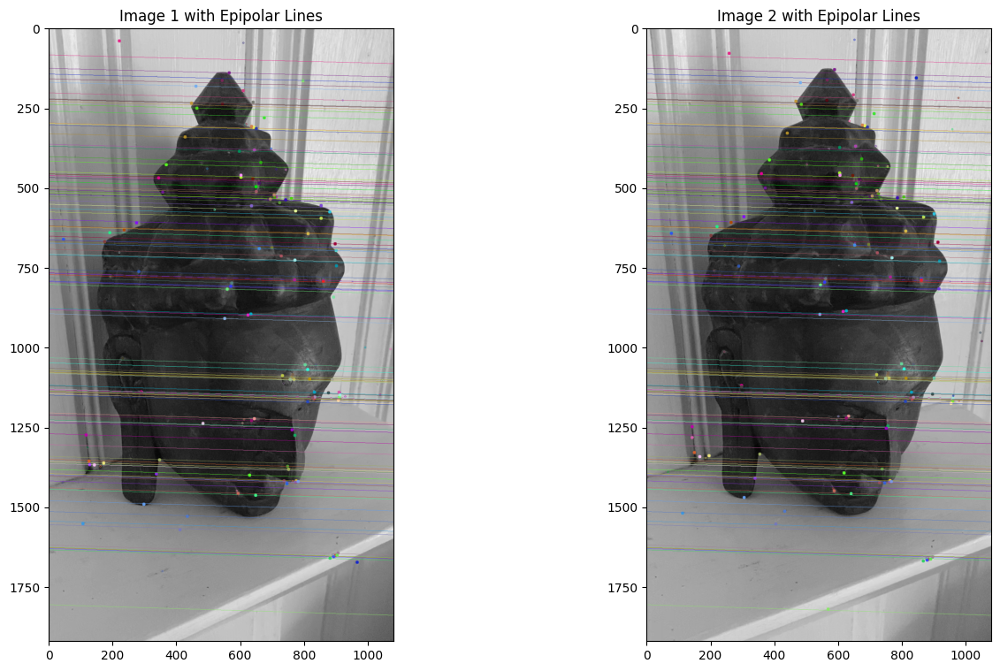

Image 7 and 8


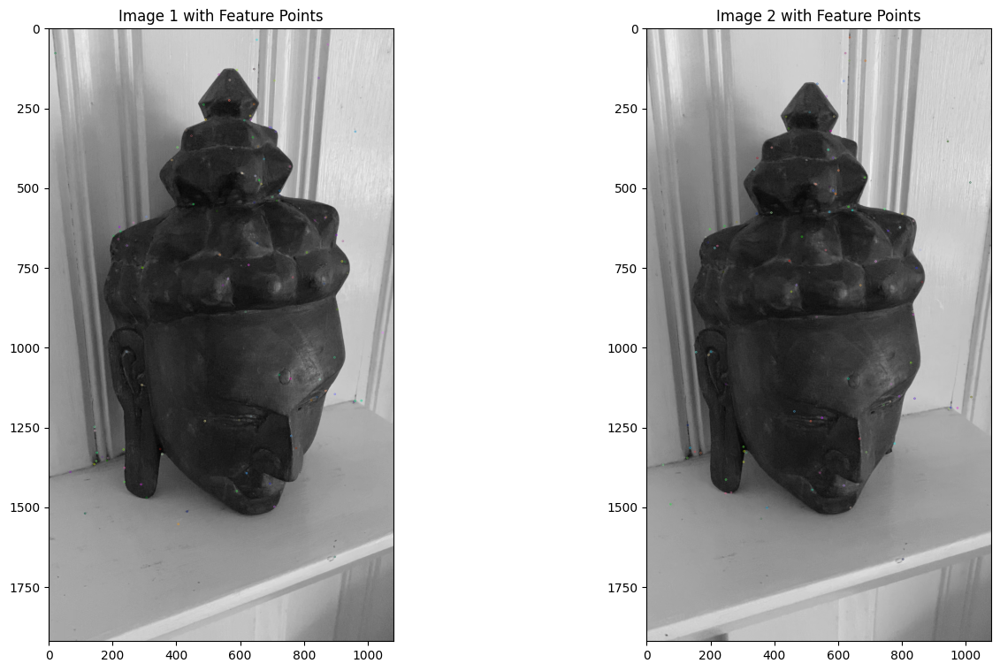

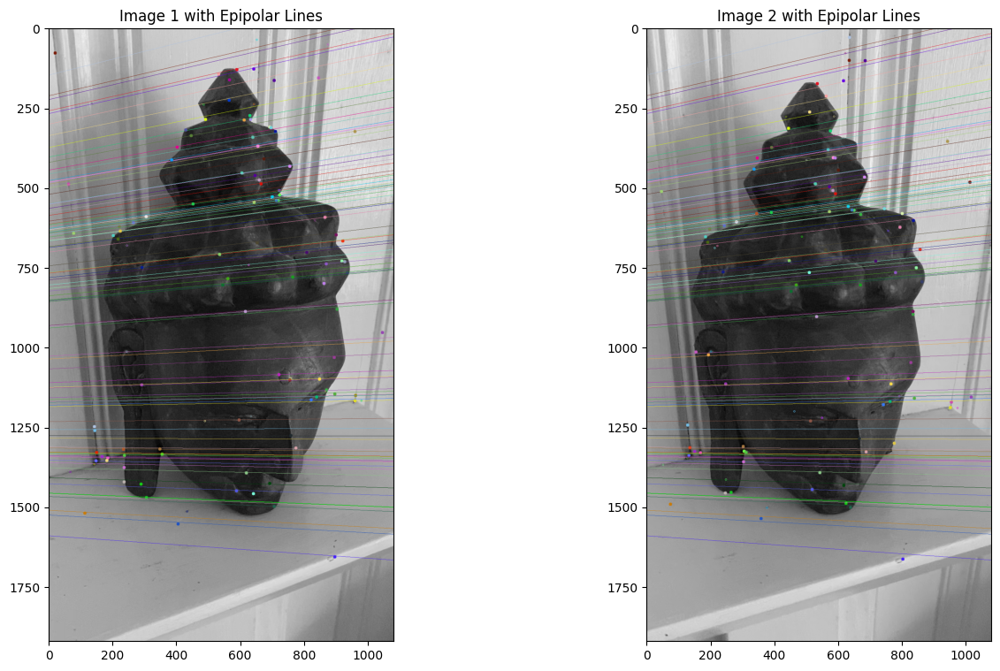

Image 8 and 9


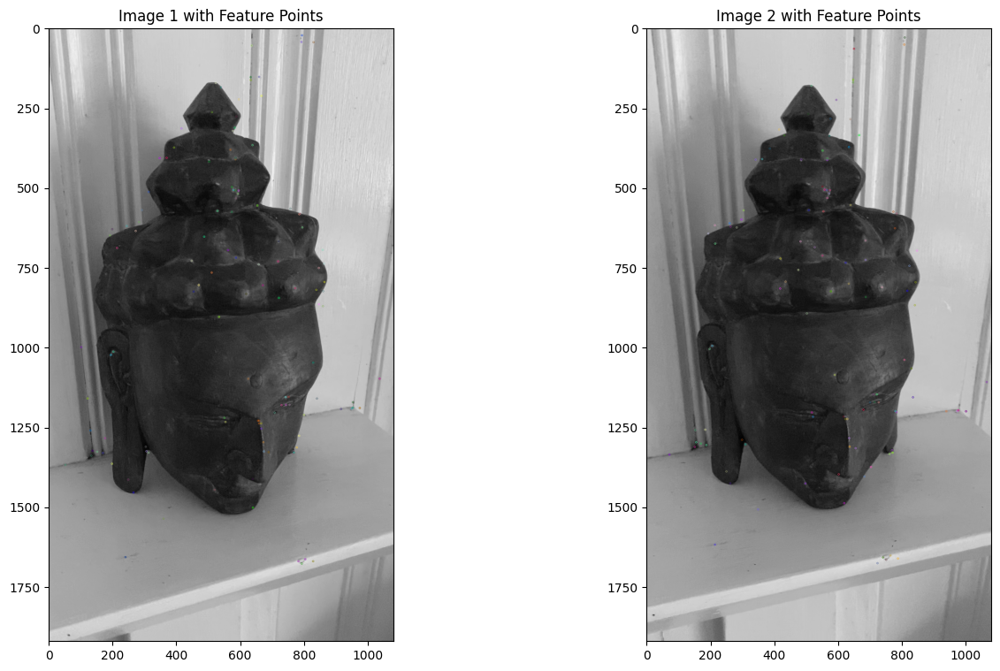

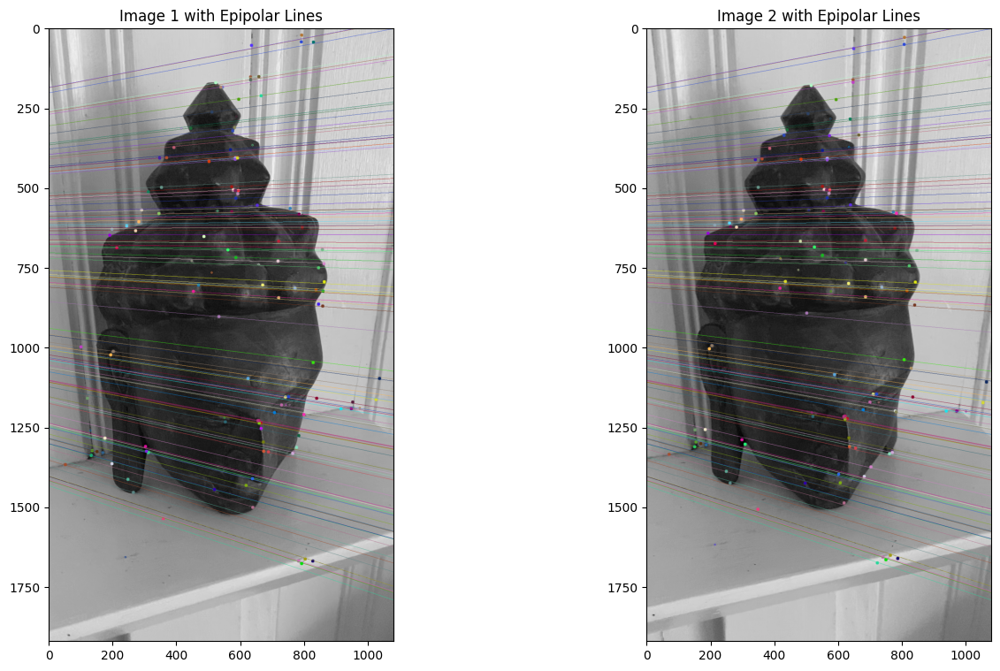

Image 9 and 10


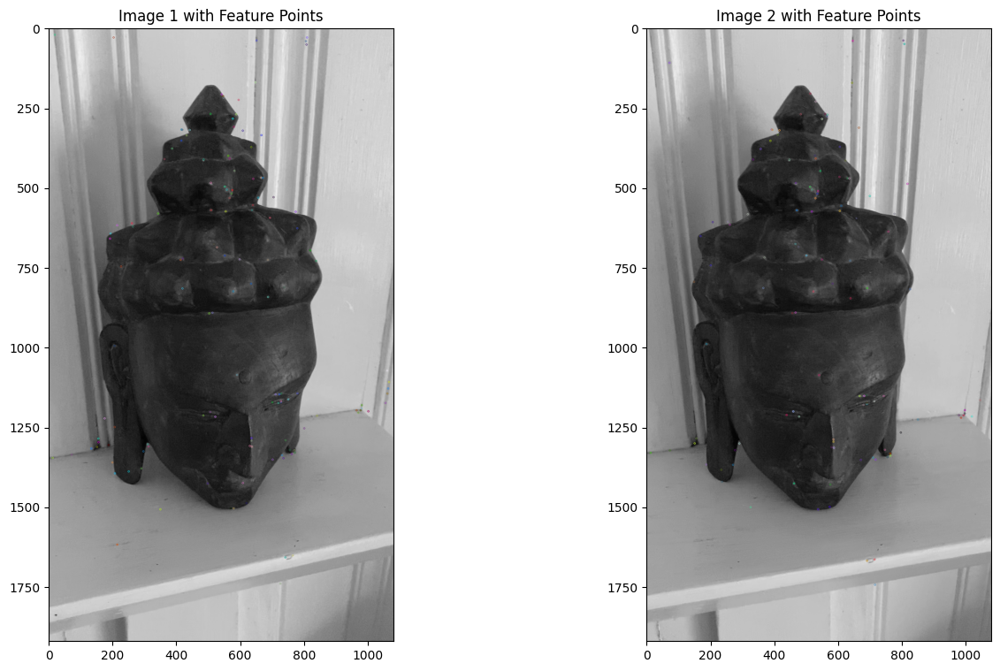

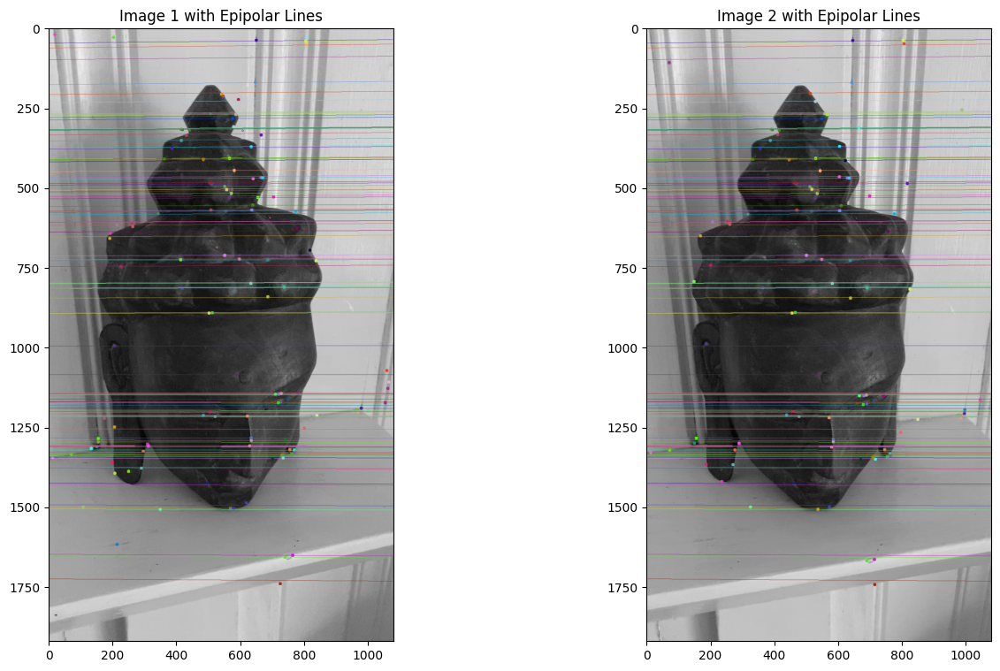

Image 10 and 11


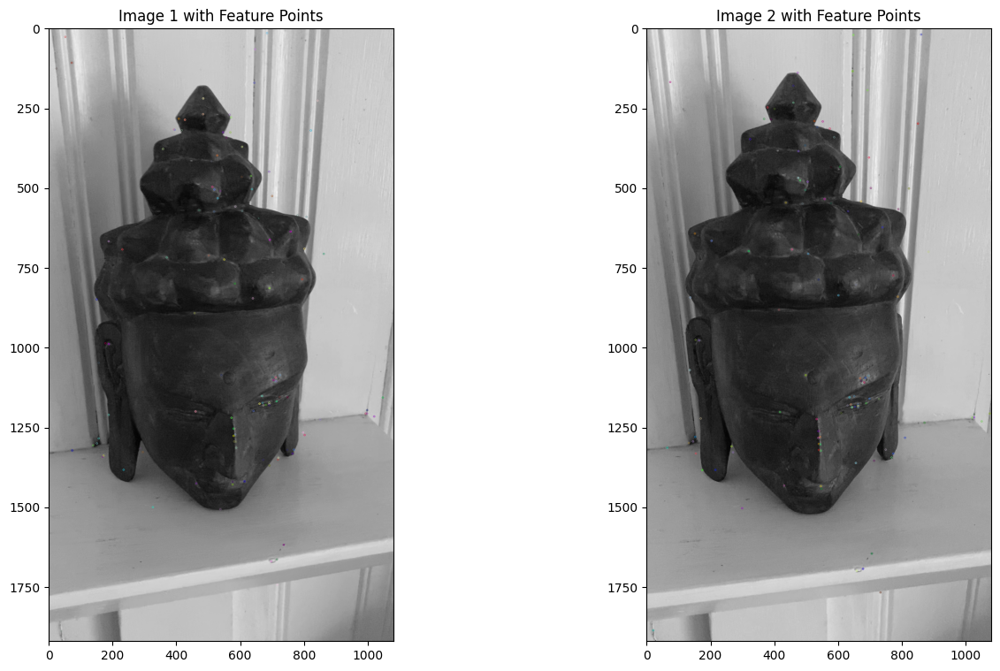

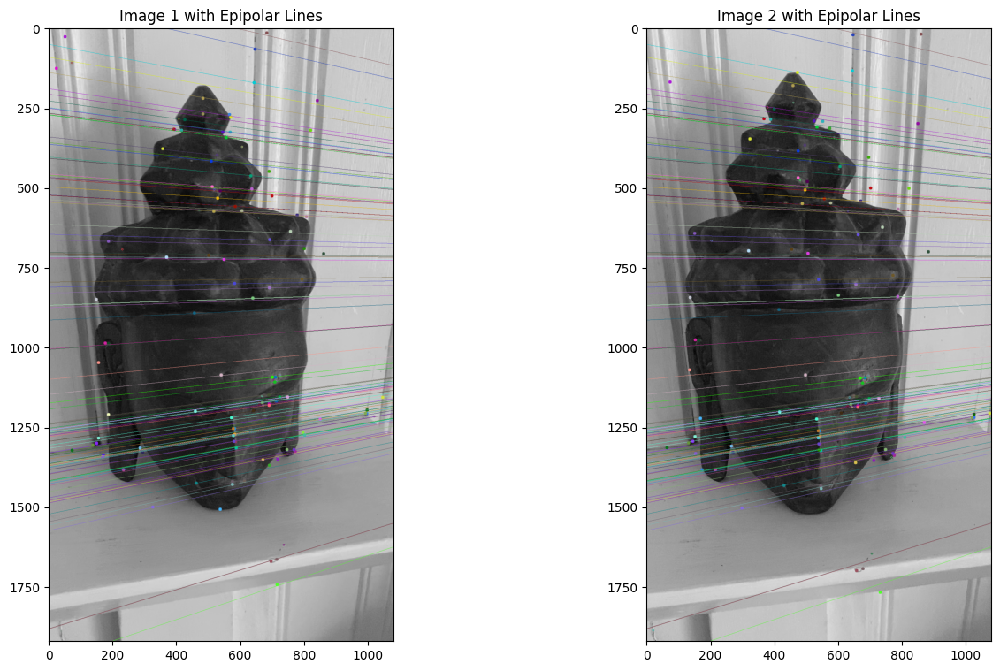

Image 11 and 12


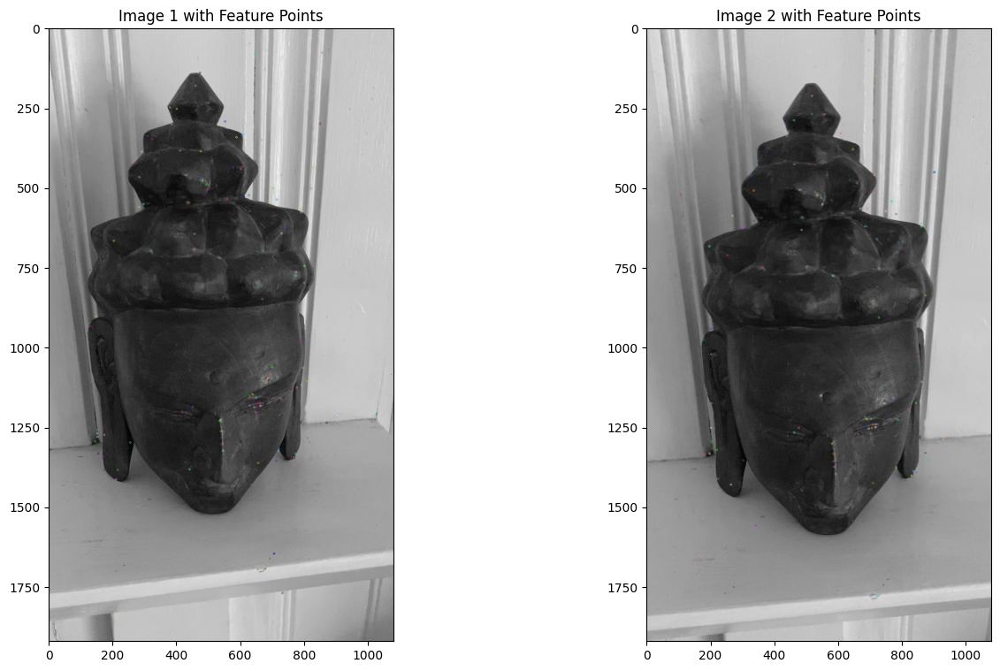

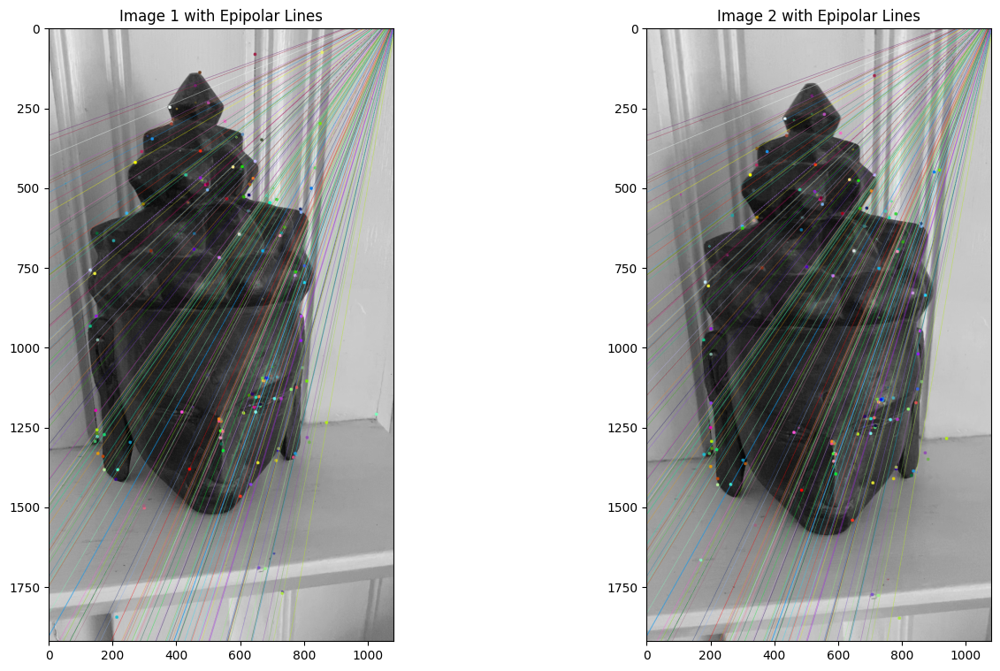

Image 12 and 13


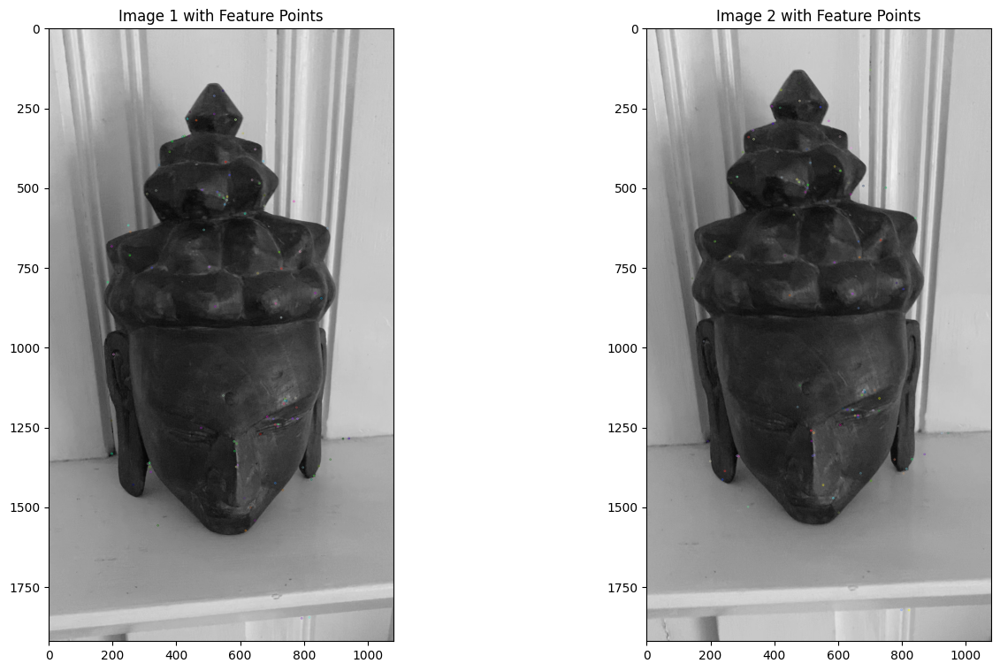

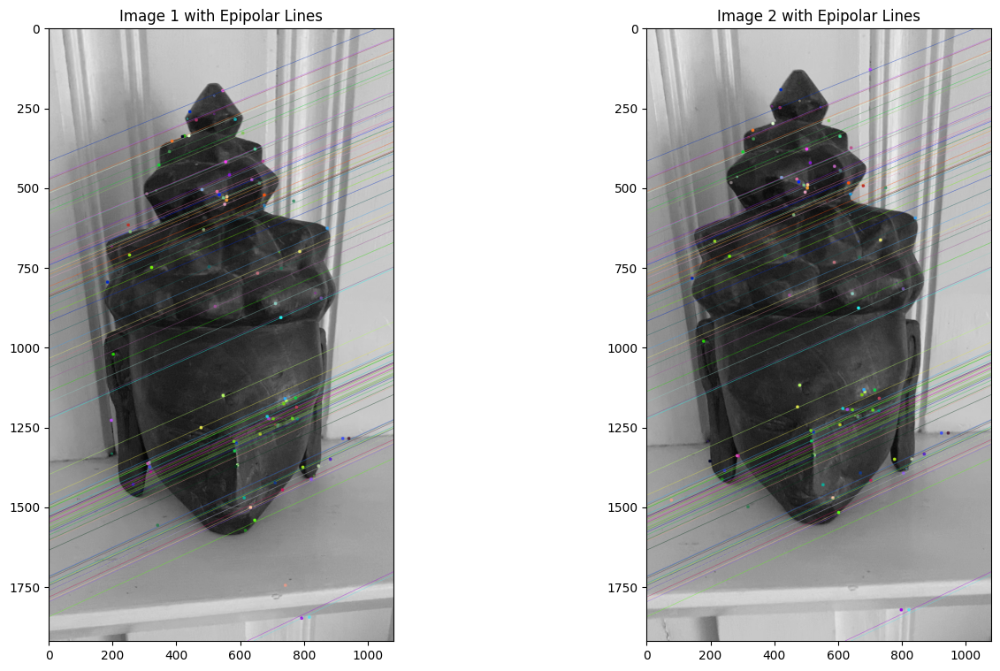

Image 13 and 14


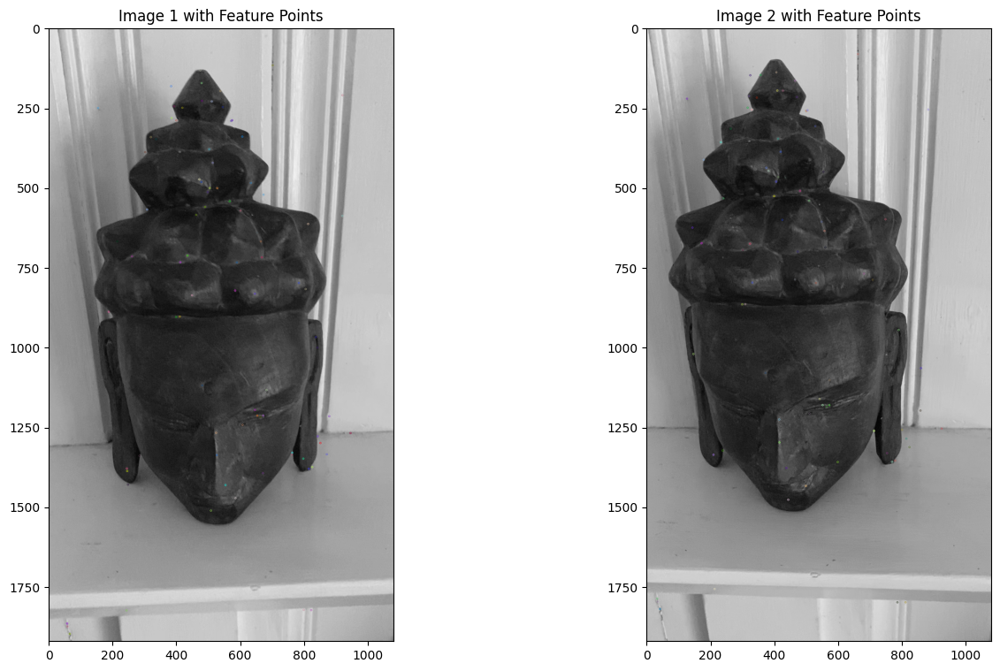

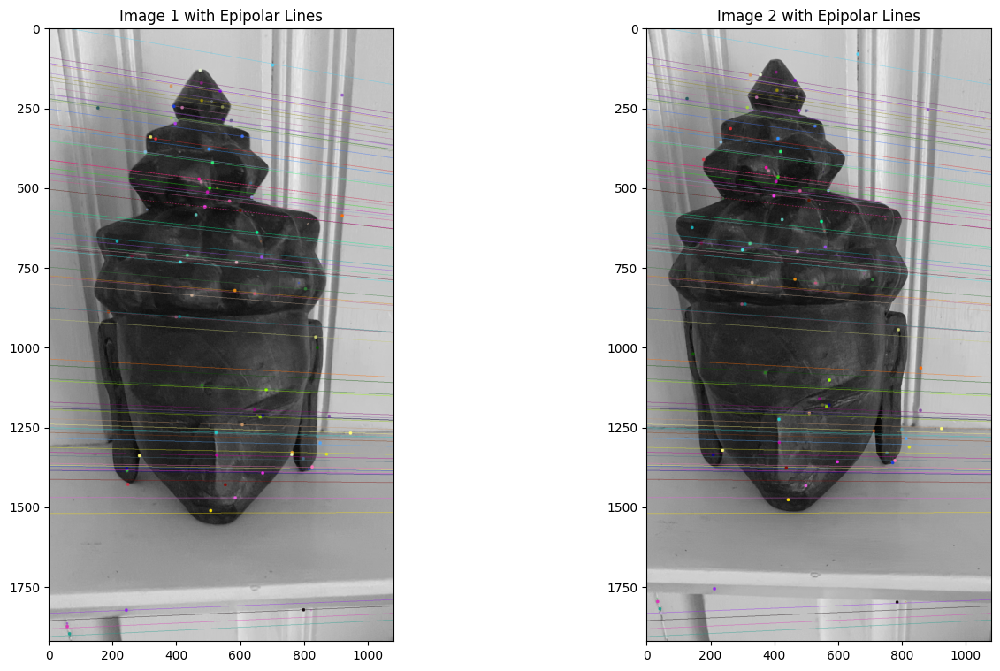

Image 14 and 15


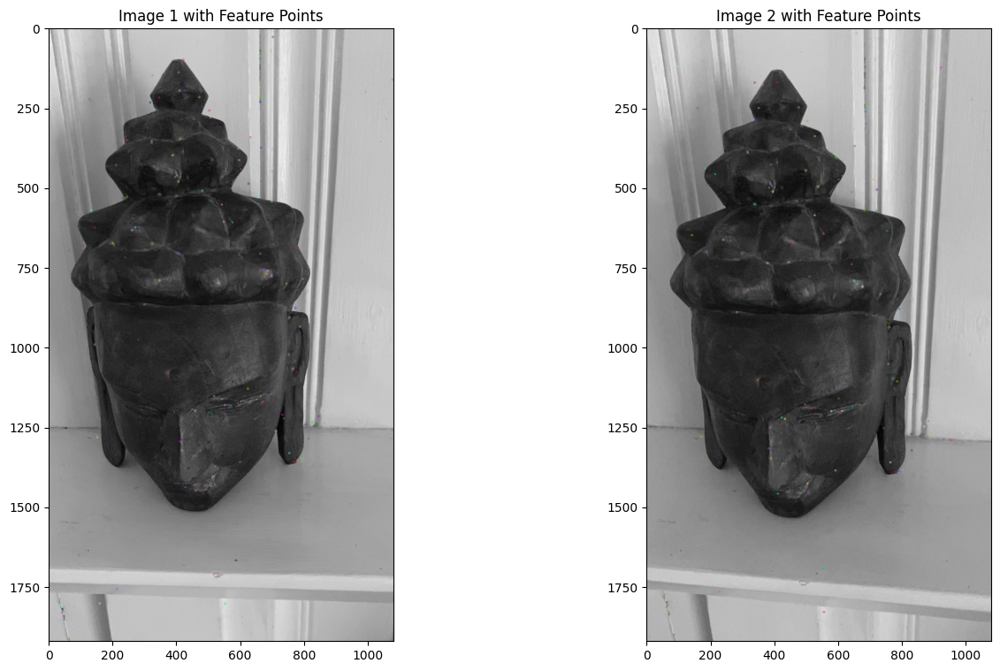

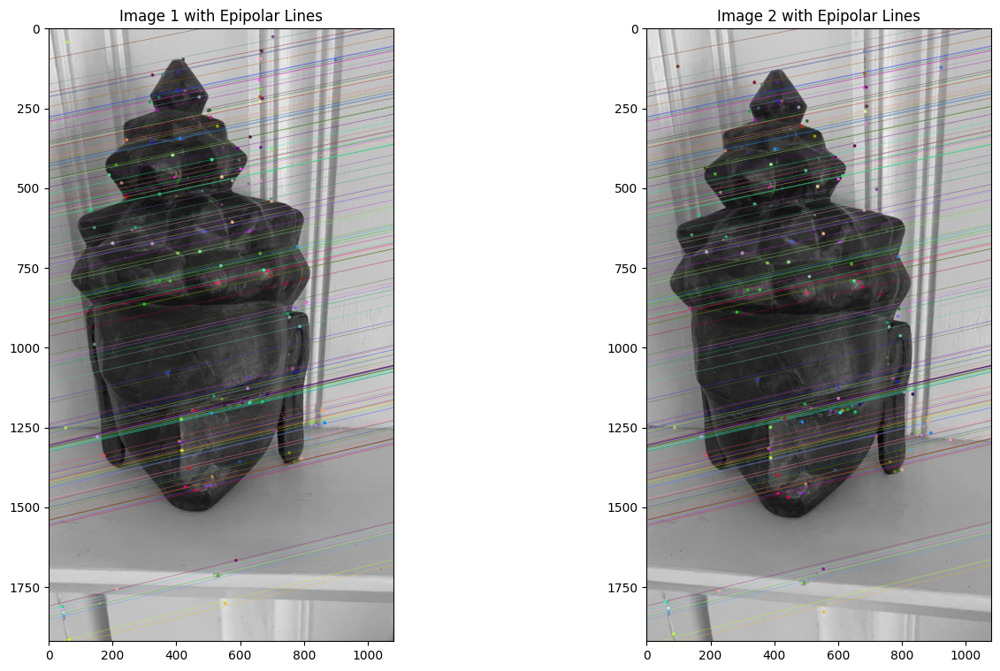

Image 15 and 16


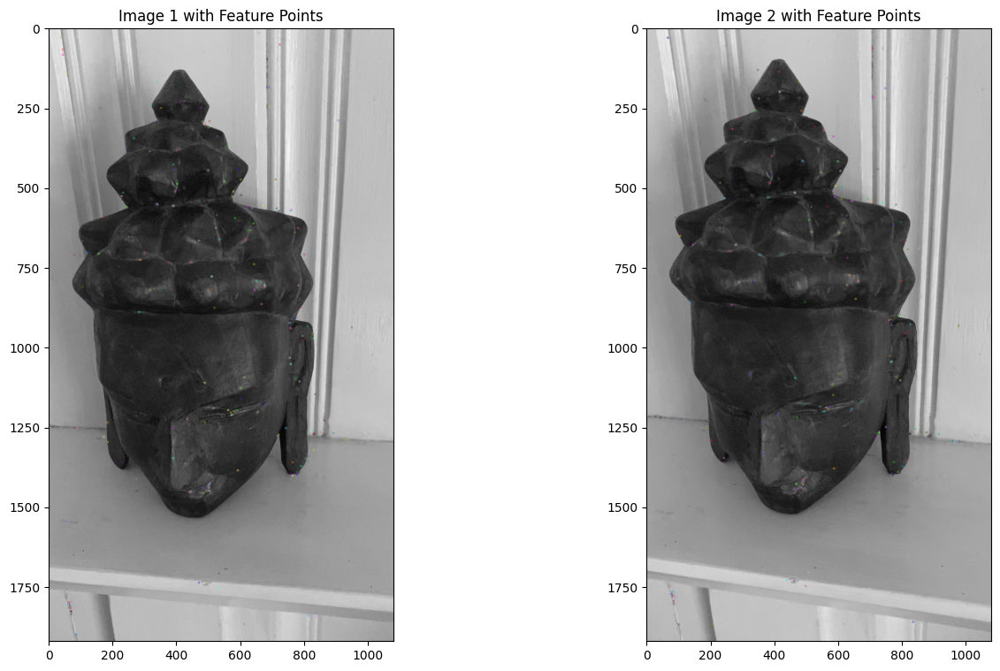

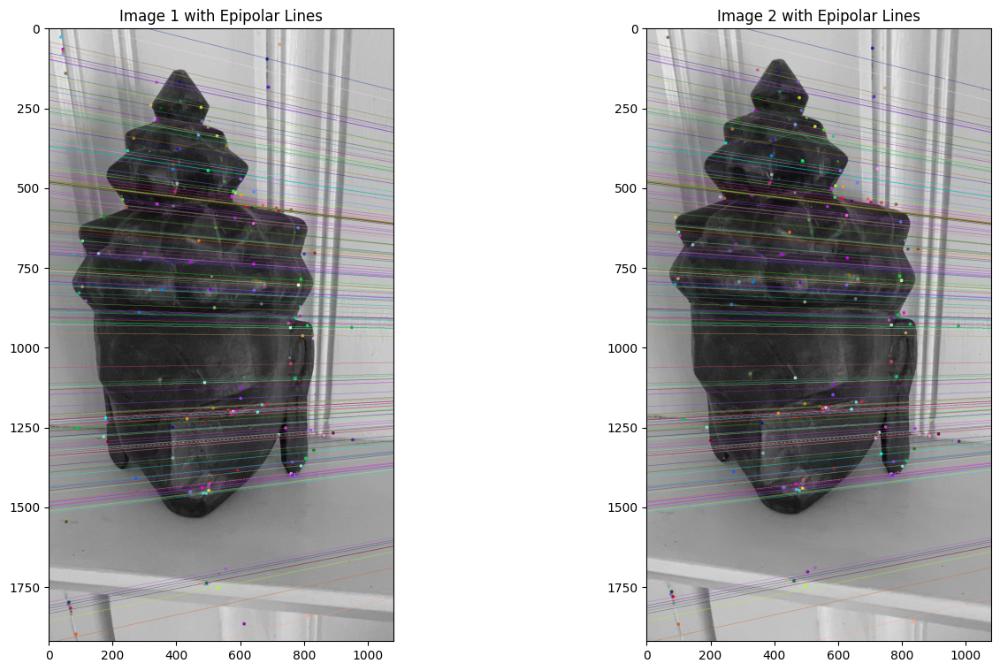

Image 16 and 17


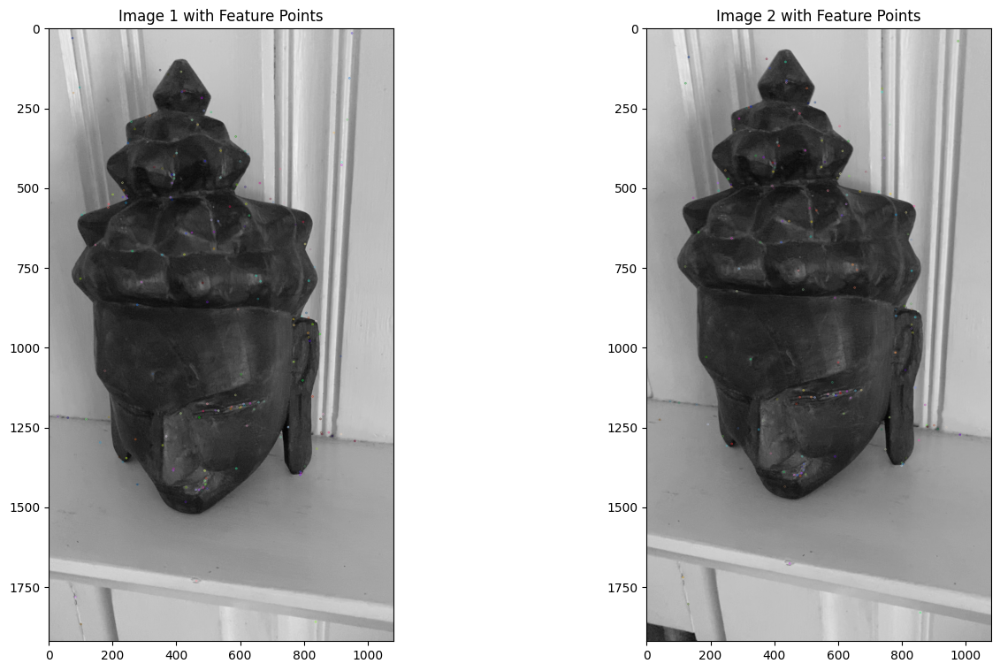

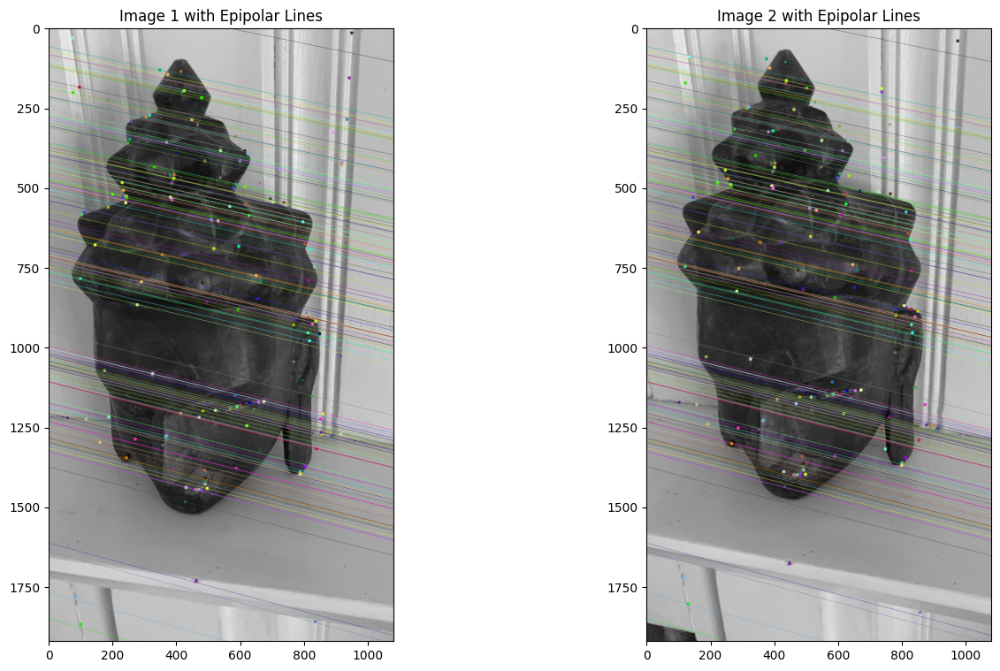

Image 17 and 18


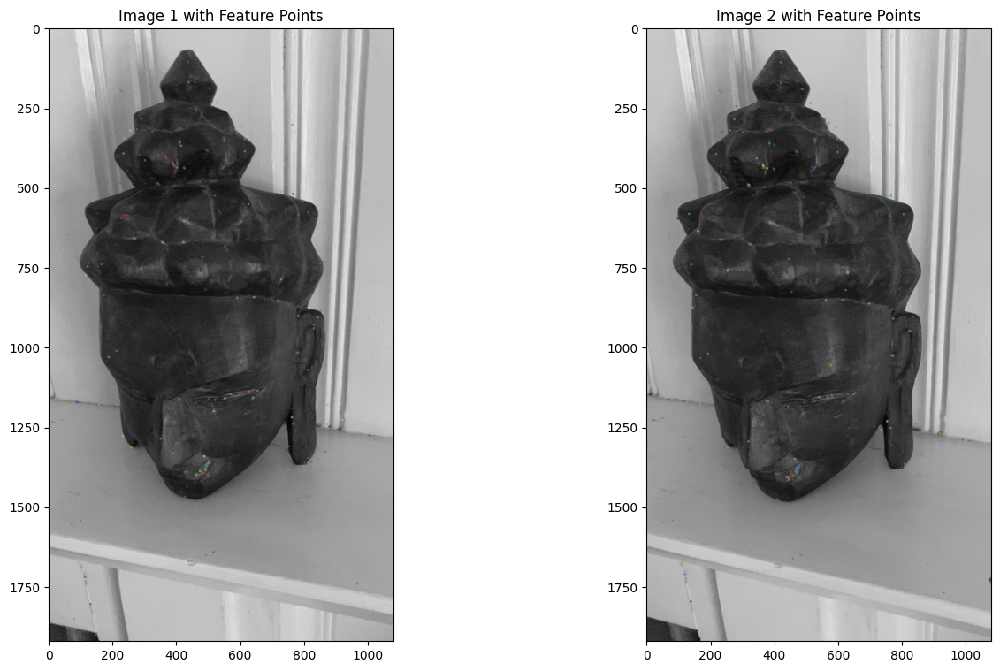

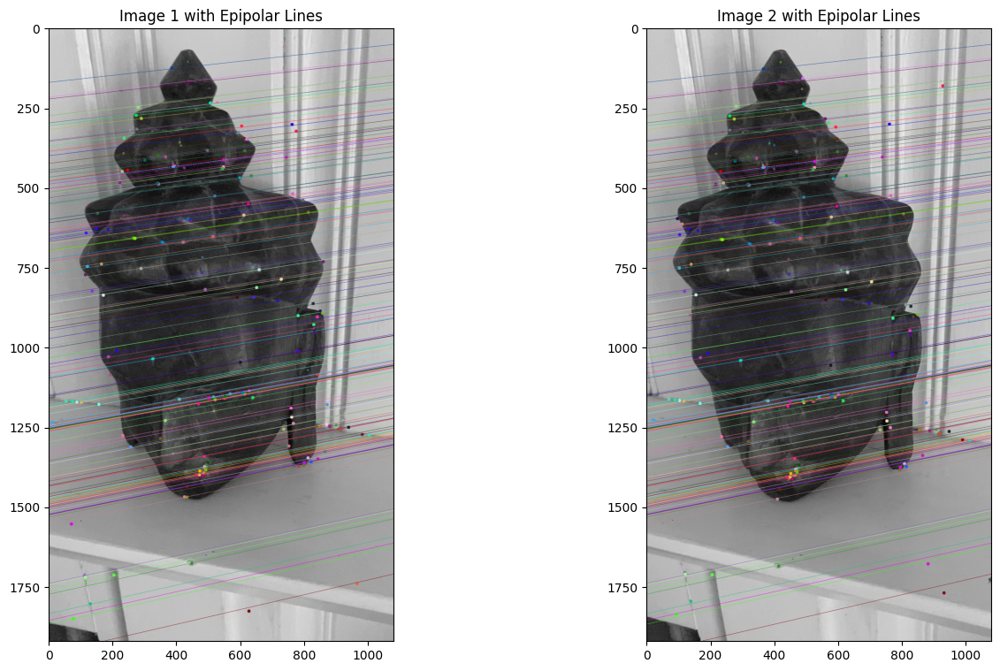

Image 18 and 19


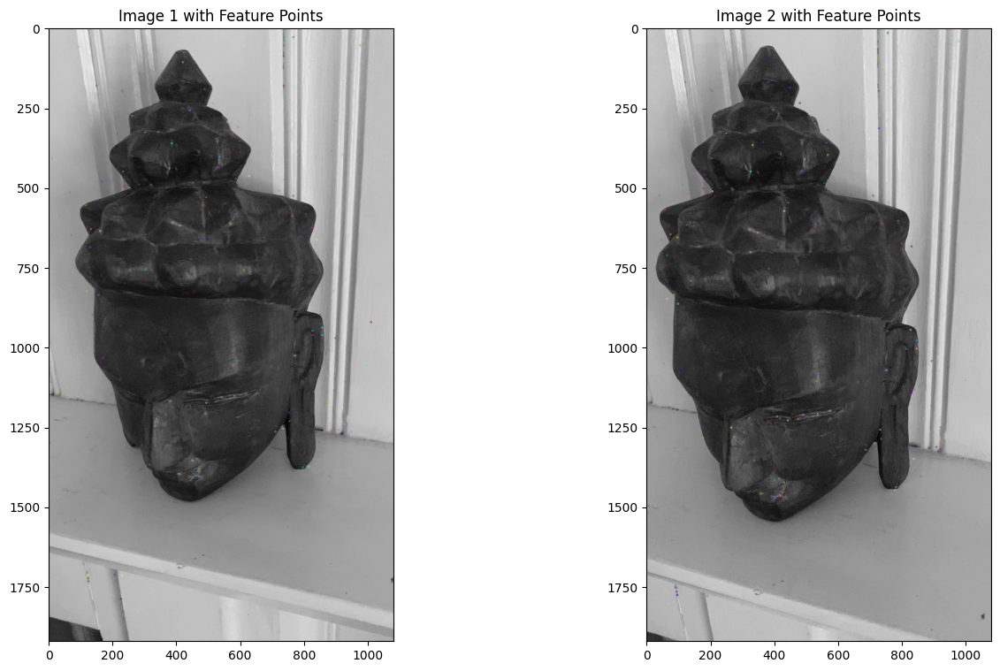

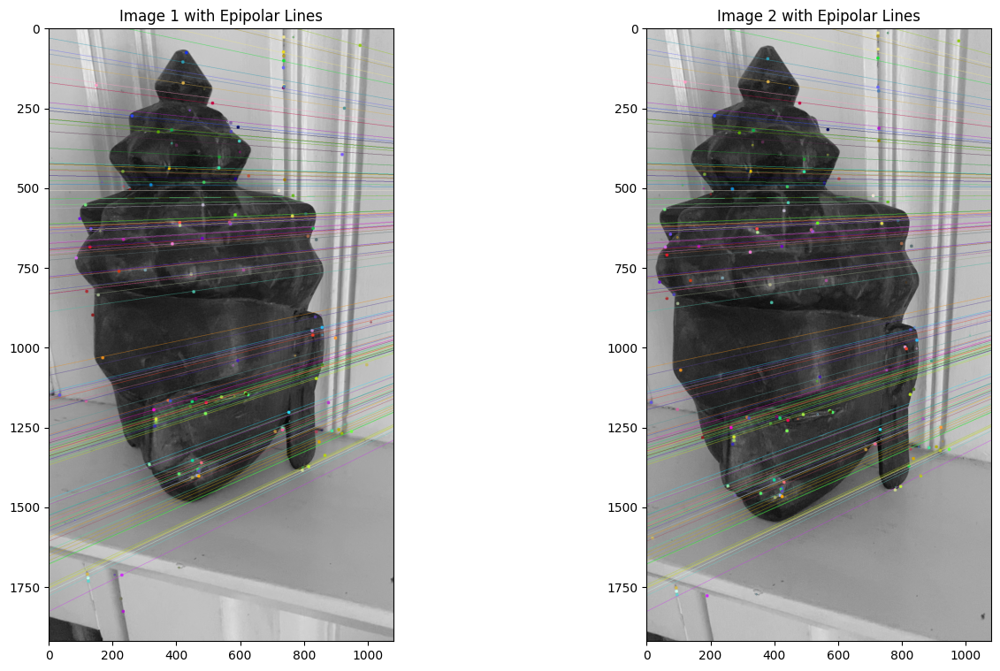

Image 19 and 20


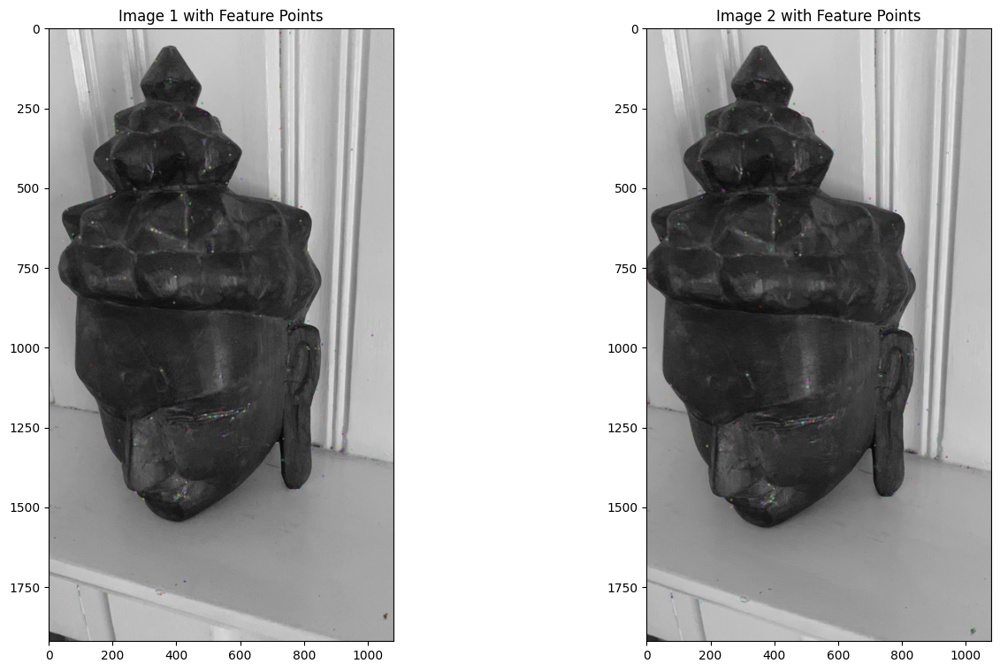

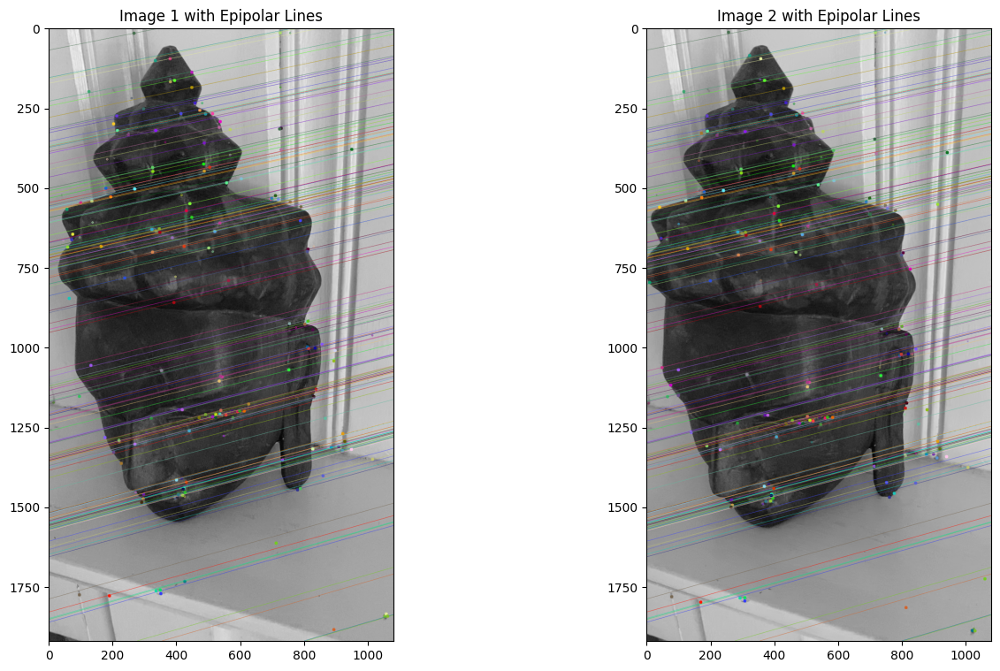

Image 20 and 21


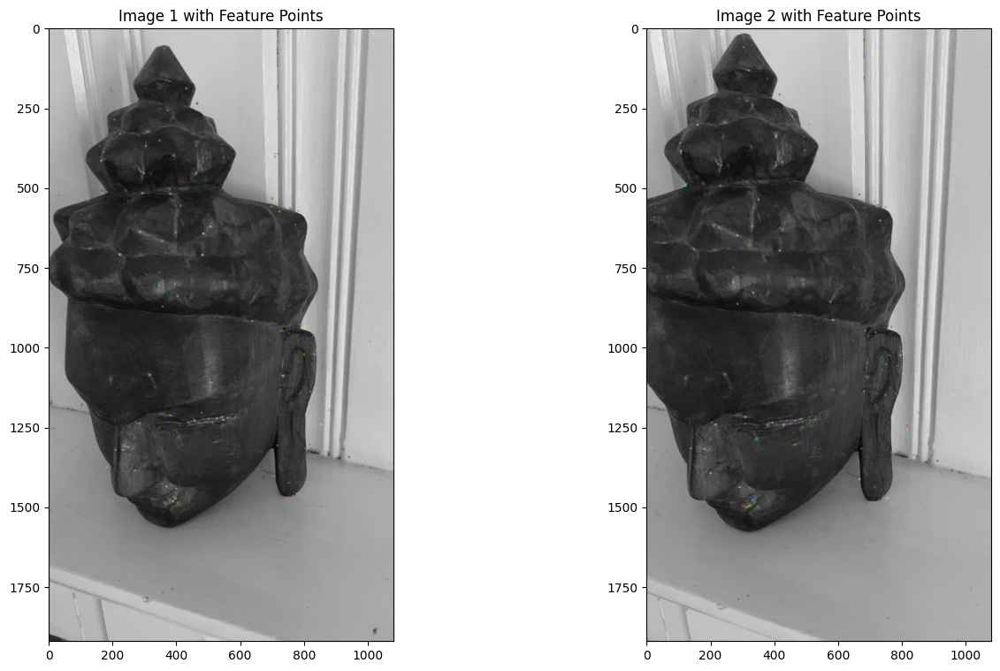

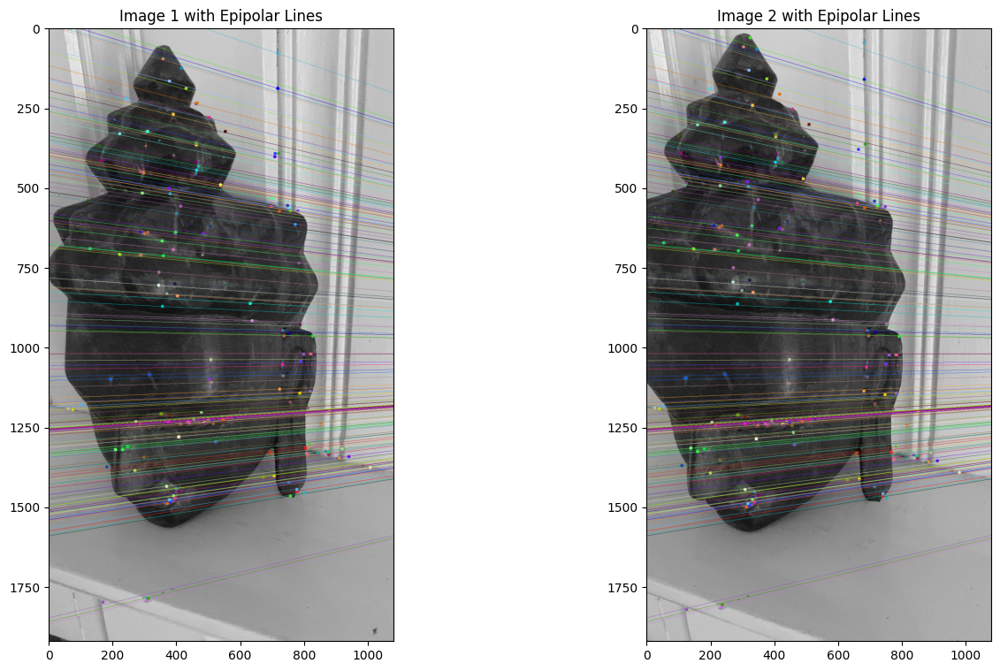

Image 21 and 22


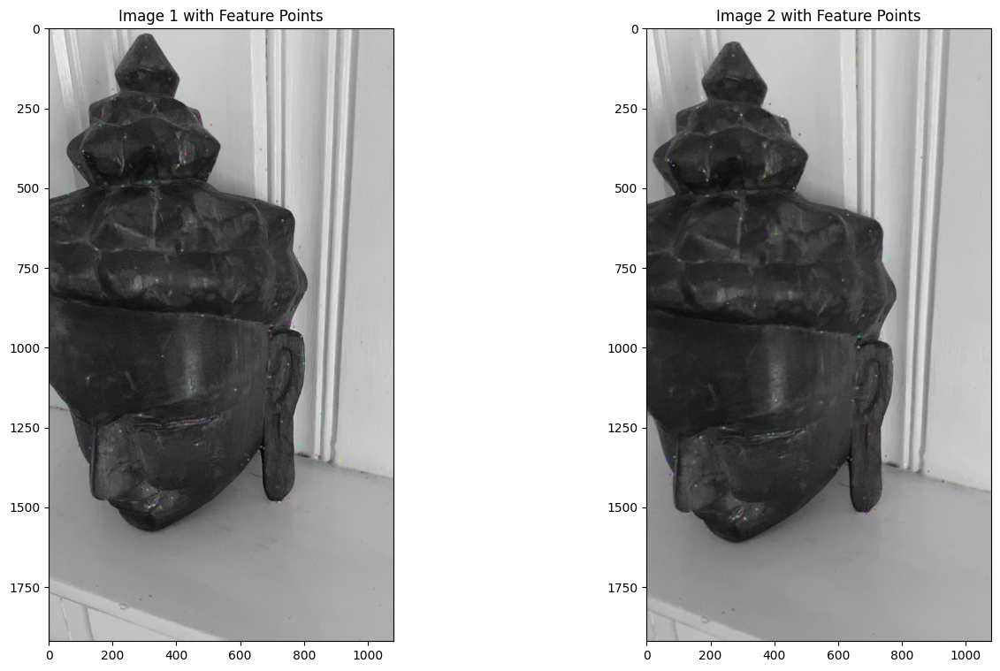

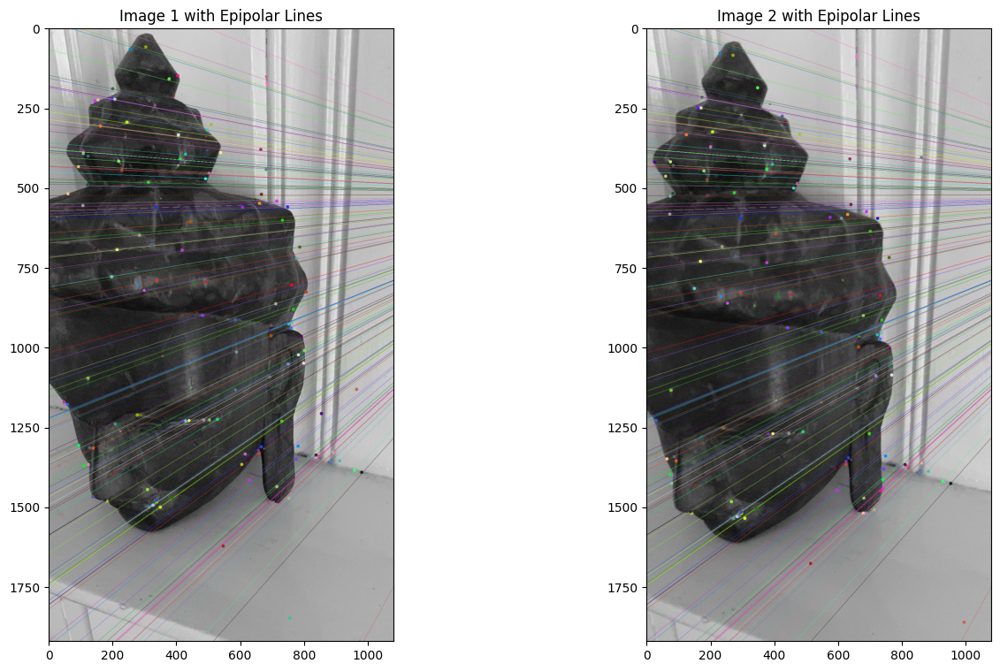

In [153]:
for i in range(1, N-2):
    print(f"Image {i} and {i+1}")
    image1, image2 = Images[i], Images[i+1]
    q1, q2 = match_images(image1, image2, i, i+1)
    E, q1, q2, mask = ComputeEssentialMatrix(q1, q2)
    matched_2d_image1, matched_3d, matched_indices = CreatePointCloud(i, prev_keypoints, pointcloud, q1)
    matched_2d_image2 = q2[matched_indices]
    ran, rvec, t, _ = cv2.solvePnPRansac(matched_3d, matched_2d_image2, K, None)

    if ran:
        R, _ = cv2.Rodrigues(rvec)
    T_2_w = CalculateTransfomationMatrix(R, t)
    camera_poses.append(np.linalg.inv(T_2_w))

    P1 = get_projection_matrix(camera_poses[i])
    P2 = get_projection_matrix(camera_poses[i+1])
    points3D, q1, q2 = Trangulation(q1, q2, P1, P2)
    update_cloud(pointcloud, i, points3D, q1, q2)
    prev_keypoints = q2

In [154]:
def PLot2(camera_poses: list, cloud: np.ndarray):
    poses = np.array([np.array(camera_pose) for camera_pose in camera_poses])
    positions = [pose[:3, 3] for pose in poses]
    orientations = [pose[:3, :3] for pose in poses]

    fig = go.Figure()

    # Add Camera Poses as markers
    fig.add_trace(go.Scatter3d(
        x=[pos[0] for pos in positions],
        y=[pos[1] for pos in positions],
        z=[pos[2] for pos in positions],
        mode='markers',
        marker=dict(size=1, color='yellow'),
        name='Camera Poses'
    ))

    # Add Axes lines
    for i, (pos, orientation) in enumerate(zip(positions, orientations)):
        axis_len = 50
        axes_endpoints = [pos + orientation.dot(np.array([axis_len, 0, 0])),
                          pos + orientation.dot(np.array([0, axis_len, 0])),
                          pos + orientation.dot(np.array([0, 0, axis_len]))]

        axis_colors = ['red', 'green', 'blue']
        axis_names = ['X-axis', 'Y-axis', 'Z-axis']

        # Add each axis line
        for endpoint, color, name in zip(axes_endpoints, axis_colors, axis_names):
            fig.add_trace(go.Scatter3d(
                x=[pos[0], endpoint[0]],
                y=[pos[1], endpoint[1]],
                z=[pos[2], endpoint[2]],
                mode='lines',
                line=dict(color=color),
                name=name
            ))

    # Filter and add Pointcloud as markers
    mask = np.linalg.norm(cloud, axis=1) < 1000
    cloud = cloud[mask]

    fig.add_trace(go.Scatter3d(
        x=cloud[:, 0],
        y=cloud[:, 1],
        z=cloud[:, 2],
        mode='markers',
        marker=dict(size=1, color='brown'),
        name='Pointcloud'
    ))

    fig.update_layout(scene=dict(xaxis=dict(title='X axis'), yaxis=dict(title='Y axis'), zaxis=dict(title='Z axis')))
    fig.show()


In [155]:
PLot2(camera_poses, np.array([point.coords for point in pointcloud]))

In [156]:
# From Aniket's Code and GTSAM website
L = gtsam.symbol_shorthand.L
X = gtsam.symbol_shorthand.X
K = gtsam.Cal3_S2(K[0, 0], K[1, 1], 0.0, K[0, 2], K[1, 2])
measurement_noise = gtsam.noiseModel.Isotropic.Sigma(2, 10.0)
graph = gtsam.NonlinearFactorGraph()
pose_noise = gtsam.noiseModel.Diagonal.Sigmas(np.array([0.2, 0.2, 0.2, 0.1, 0.1, 0.1]))
factor = gtsam.PriorFactorPose3(X(0), gtsam.Pose3(camera_poses[0]), pose_noise)
graph.push_back(factor)

for j, point in enumerate(pointcloud):
    keys = list(point.origin.keys())
    for i in keys:
        measurement = point.origin[i]
        factor = gtsam.GenericProjectionFactorCal3_S2(measurement, measurement_noise, X(int(i)), L(j), K)
        graph.push_back(factor)
point_noise = gtsam.noiseModel.Isotropic.Sigma(3, 1)
factor = gtsam.PriorFactorPoint3(L(0), gtsam.Point3(pointcloud[0].coords), point_noise)
graph.push_back(factor)
initial_estimate = gtsam.Values()
for i in range(N-2):
    initial_estimate.insert(X(i), gtsam.Pose3(camera_poses[i]))
initial_estimate.insert(X(22), gtsam.Pose3(camera_poses[21]))
for j, point in enumerate(pointcloud):
    initial_estimate.insert(L(j), gtsam.Point3(point.coords))
params = gtsam.LevenbergMarquardtParams()
params.setVerbosityLM("SUMMARY")
optimizer = gtsam.LevenbergMarquardtOptimizer(graph, initial_estimate, params)
result = optimizer.optimize()
print("Error: ", graph.error(result))



Error:  5.745871660265363


In [157]:
for i in range(N-2):
    camera_poses[i] = result.atPose3(X(i)).matrix()
for j, point in enumerate(pointcloud):
    pointcloud[j].coords = result.atPoint3(L(j))

In [158]:
PLot2(camera_poses, np.array([point.coords for point in pointcloud]))